# Test OD binning

In [ ]:
#standard packages
from bokeh.plotting import figure,show
from bokeh.io import output_notebook

In [2]:
output_notebook()

Loading BokehJS ...

In [1]:
#custom packages
import pypsg.OD as OD
from pypsg.utils import read_out

In [33]:
df = read_out('/home/buriola/PSG/PSG4Mars/data/lyo/CO2/lyo_CO2_0_freq600_650.txt')

In [34]:
df.set_index('freq', inplace=True)

In [35]:
import matplotlib.pyplot as plt
import numpy as np

In [36]:
df = df.iloc[:,:-1]

In [37]:
df

,0.0000e+00,3.9563e+00,4.5349e+00,5.1109e+00,5.6249e+00,6.1476e+00,6.7030e+00,7.2681e+00,7.8630e+00,8.4193e+00,...,7.0833e+01,7.6577e+01,8.2294e+01,8.7853e+01,9.3191e+01,9.8392e+01,1.0350e+02,1.0845e+02,1.1319e+02,1.1574e+02
freq,,,,,,,,,,,,,,,,,,,,,
650.0000,28.206,16.5470,14.1700,12.3290,10.9030,9.6738,8.5885,7.6062,6.7492,6.0889,...,2.408400e-06,5.960500e-07,1.495400e-07,3.823500e-08,9.621500e-09,2.395400e-09,5.982000e-10,1.505100e-10,4.829200e-11,9.289800e-12
649.9999,28.271,16.5850,14.2030,12.3580,10.9290,9.6962,8.6084,7.6239,6.7649,6.1031,...,2.414000e-06,5.974500e-07,1.499000e-07,3.832700e-08,9.644900e-09,2.401300e-09,5.996900e-10,1.508900e-10,4.841700e-11,9.313800e-12
649.9998,28.336,16.6240,14.2360,12.3860,10.9540,9.7190,8.6286,7.6418,6.7809,6.1175,...,2.419700e-06,5.988700e-07,1.502500e-07,3.842000e-08,9.668500e-09,2.407200e-09,6.011900e-10,1.512800e-10,4.854300e-11,9.338000e-12
649.9997,28.403,16.6630,14.2700,12.4160,10.9800,9.7420,8.6491,7.6599,6.7970,6.1320,...,2.425500e-06,6.003000e-07,1.506200e-07,3.851400e-08,9.692400e-09,2.413200e-09,6.027000e-10,1.516700e-10,4.867100e-11,9.362500e-12
649.9996,28.470,16.7020,14.3030,12.4450,11.0060,9.7652,8.6698,7.6783,6.8133,6.1467,...,2.431400e-06,6.017500e-07,1.509800e-07,3.860900e-08,9.716600e-09,2.419300e-09,6.042400e-10,1.520600e-10,4.880100e-11,9.387200e-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
600.0005,11.945,7.0508,7.0796,6.9308,6.6030,6.1281,5.5826,5.0526,4.5656,4.1804,...,4.436600e-07,1.045900e-07,2.173300e-08,4.087700e-09,8.294300e-10,1.754900e-10,3.455900e-11,5.993800e-12,1.309000e-12,2.793800e-13
600.0004,12.066,7.1224,7.1516,7.0013,6.6702,6.1905,5.6394,5.1040,4.6121,4.2230,...,4.481900e-07,1.056600e-07,2.195500e-08,4.129500e-09,8.379200e-10,1.772900e-10,3.491300e-11,6.055300e-12,1.322200e-12,2.822500e-13
600.0003,12.189,7.1952,7.2247,7.0729,6.7384,6.2538,5.6971,5.1562,4.6593,4.2662,...,4.527900e-07,1.067400e-07,2.218100e-08,4.172000e-09,8.465500e-10,1.791200e-10,3.527300e-11,6.117800e-12,1.335700e-12,2.851600e-13


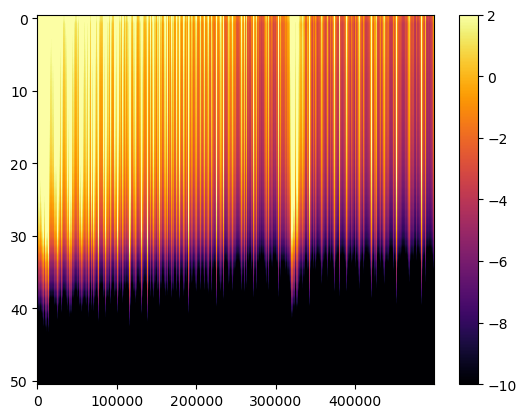

In [42]:
plt.imshow(np.log(df.T), aspect='auto', cmap = 'inferno', vmin=-10, vmax = 2)
plt.colorbar() 
#plt.xticks(range(df.shape[1]), df.columns) 
#plt.yticks(range(6), np.arange(650,710,10)) 
plt.show()

In [22]:
np.exp(-np.exp(3))

1.8921786948382924e-09

In [4]:
df_2 = read_out('../data/lyo/lyo_0_0_20191223-0000_CO2_0.01.txt')
df_3 = read_out('../data/lyo/lyo_0_0_20191223-0000_CO2_0.001.txt')
df_4 = read_out('../data/lyo/lyo_0_0_20191223-0000_CO2_0.0001.txt')

In [5]:
df_lr = OD.OD_compute(df_2)
df_mr = OD.OD_compute(df_3)
df_hr = OD.OD_compute(df_4)

In [6]:
df_lr_bin = OD.OD_binning(df_hr,df_lr)

In [7]:

p = figure(x_axis_label = 'Frequency [cm-1]', y_axis_label = 'OD', width=1200, height = 500, y_axis_type='log', title = 'OD CO2')
p.line(df_hr.freq,df_hr.level_25, line_alpha = 0.5, legend_label = 'high resolution OD', line_color='green', width = 2)
p.scatter(df_lr.freq,df_lr.level_25, marker = 'cross', size = 10, line_color='red', legend_label = 'low resolution OD (from PSG)')
p.scatter(df_lr_bin.freq,df_lr_bin.level_25, marker = 'dot', size = 15, line_color='blue', legend_label = 'high resolution binned OD')
show(p)

In [8]:
df_mr_bin = OD.OD_binning(df_hr,df_mr)

In [10]:
p = figure(x_axis_label = 'Frequency [cm-1]', y_axis_label = 'OD', width=1200, height = 500, y_axis_type='log', title = 'OD CO2')
p.line(df_hr.freq,df_hr.level_39, line_alpha = 0.5, legend_label = 'high resolution OD', line_color='green', width = 2)
p.scatter(df_mr.freq,df_mr.level_39, marker = 'cross', size = 10, line_color='red', legend_label = 'low resolution OD (from PSG)')
p.scatter(df_mr_bin.freq,df_mr_bin.level_39, marker = 'dot', size = 15, line_color='blue', legend_label = 'high resolution binned OD')
show(p)